In [11]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import dash_bio
import scipy
import math

In [12]:
data = pd.read_parquet('max_gve.parquet.gzip')
data

,chrom,pos,name,abs_max_effect,max_column,ave_effect
0,1,174946171,rs147831690,0.027101,nrnlsc_H3K79me1,0.000700
1,1,174946180,rs1389168246,0.024842,nrnlsc_H3K79me1,0.000408
2,1,174946196,rs1374951931,0.072019,nrnlsc_H3K79me1,0.001219
3,1,174946202,rs948828419,0.033973,nrnlsc_H3K79me1,0.001874
4,1,174946211,rs896018724,0.064587,nrnlsc_H3K79me1,0.001534
...,...,...,...,...,...,...
547681,2,156681080,rs747765225,0.009990,SKNSH_ARNTL,0.000462
547682,2,156681082,rs994964368,0.009063,cdtn_H3K4me3,0.000822
547683,2,156681084,rs1028224262,0.008285,SKNSH_ARNTL,0.000428
547684,2,156681085,rs541069773,0.016144,SKNSH_ARNTL,0.000941


In [18]:
dfs = []
for i in range(10):
    print(i)
    df = data.iloc[:1000, :]
    dfs.append(df)
print(df.head())

0
1
2
3
4
5
6
7
8
9
   chrom        pos          name  abs_max_effect       max_column  ave_effect
0      1  174946171   rs147831690        0.027101  nrnlsc_H3K79me1    0.000700
1      1  174946180  rs1389168246        0.024842  nrnlsc_H3K79me1    0.000408
2      1  174946196  rs1374951931        0.072019  nrnlsc_H3K79me1    0.001219
3      1  174946202   rs948828419        0.033973  nrnlsc_H3K79me1    0.001874
4      1  174946211   rs896018724        0.064587  nrnlsc_H3K79me1    0.001534


In [21]:
dfs = pd.concat(dfs)

In [22]:
dfs

,chrom,pos,name,abs_max_effect,max_column,ave_effect
0,1,174946171,rs147831690,0.027101,nrnlsc_H3K79me1,0.000700
1,1,174946180,rs1389168246,0.024842,nrnlsc_H3K79me1,0.000408
2,1,174946196,rs1374951931,0.072019,nrnlsc_H3K79me1,0.001219
3,1,174946202,rs948828419,0.033973,nrnlsc_H3K79me1,0.001874
4,1,174946211,rs896018724,0.064587,nrnlsc_H3K79me1,0.001534
...,...,...,...,...,...,...
995,1,174949547,rs1573971060,0.042717,MOC_NP_ATAC,0.001534
996,1,174949551,rs1158195944,0.005916,SKNSH_H3F3A,0.000336
997,1,174949556,rs191506112,0.006997,ACC_NP_ATAC,0.000302
998,1,174949557,rs557939733,0.005723,ACC_NP_ATAC,0.000226


In [58]:
data = pd.read_csv('max_gve.csv')
data['chrom'][data.chrom=='X'] = 23
data['chrom'][data.chrom=='Y'] = 24
data['chrom'][data.chrom=='16.0'] = 16
data['chrom'] = data.chrom.astype(int)
data

,chrom,pos,name,max_effect,max_column,ave_effect
0,1,238807165,rs1207962803,0.015620,brnmec_DNase,0.000920
1,1,238807165,rs1242649293,0.081236,nrnlsc_H3K9ac,-0.002660
2,1,238807167,rs997302978,0.002643,ACC_NP_ATAC,-0.001335
3,1,238807168,rs1270214146,0.045428,nrnlsc_H3K79me1,-0.000773
4,1,238807168,rs1270214146,0.083614,nrnlsc_H3K79me1,0.001402
...,...,...,...,...,...,...
16652518,2,156681080,rs747765225,0.006044,PMC_NN_ATAC,-0.000144
16652519,2,156681082,rs994964368,0.000293,MeT_NN_ATAC,-0.000791
16652520,2,156681084,rs1028224262,0.004548,VPC_NN_ATAC,-0.000109
16652521,2,156681085,rs541069773,0.011259,VPC_NN_ATAC,-0.000122


In [59]:
data.chrom.unique()

array([ 1, 22,  3, 12, 16, 17, 13, 10, 11,  2, 19, 14, 15, 21])

In [62]:
neg = -(data.max_effect.values)
exp = np.exp(neg)
data['exp'] = exp

zscores = scipy.stats.zscore(data.ave_effect.values)
data['zscore'] = zscores
pvalues = scipy.stats.norm.sf(zscores)
data['p'] = pvalues

data

,chrom,pos,name,max_effect,max_column,ave_effect,exp,zscore,p
0,1,238807165,rs1207962803,0.015620,brnmec_DNase,0.000920,0.984502,0.310131,0.378231
1,1,238807165,rs1242649293,0.081236,nrnlsc_H3K9ac,-0.002660,0.921976,-0.931275,0.824144
2,1,238807167,rs997302978,0.002643,ACC_NP_ATAC,-0.001335,0.997360,-0.471795,0.681464
3,1,238807168,rs1270214146,0.045428,nrnlsc_H3K79me1,-0.000773,0.955588,-0.276915,0.609077
4,1,238807168,rs1270214146,0.083614,nrnlsc_H3K79me1,0.001402,0.919786,0.477353,0.316555
...,...,...,...,...,...,...,...,...,...
16652518,2,156681080,rs747765225,0.006044,PMC_NN_ATAC,-0.000144,0.993974,-0.058674,0.523394
16652519,2,156681082,rs994964368,0.000293,MeT_NN_ATAC,-0.000791,0.999707,-0.283229,0.611499
16652520,2,156681084,rs1028224262,0.004548,VPC_NN_ATAC,-0.000109,0.995462,-0.046438,0.518520
16652521,2,156681085,rs541069773,0.011259,VPC_NN_ATAC,-0.000122,0.988804,-0.050923,0.520306


In [63]:
data.to_csv('abs_max_ave_effect_pvalue.csv', index=False)

In [41]:
data = pd.read_csv('tbln_H3K27ac_kmeans0.csv')
data['chrom'][data.chrom=='X'] = 23
data['chrom'][data.chrom=='Y'] = 24
data['chrom'][data.chrom=='16.0'] = 16
data['chrom'] = data.chrom.astype(int)
data

,chrom,pos,name,tbln_H3K27ac,diff,abs_diff
0,10,84139514.0,rs932821133,0.105500,0.105500,0.105500
1,10,84139543.0,rs1229596357,-0.183456,-0.183456,0.183456
2,10,84139573.0,rs1481839079,0.143182,0.143182,0.143182
3,10,84140064.0,rs1452183496,0.136644,0.136644,0.136644
4,10,84140294.0,rs1429667538,0.100358,0.100358,0.100358
...,...,...,...,...,...,...
726226,3,194089744.0,rs1351149363,-0.218239,-0.218239,0.218239
726227,3,194089846.0,rs890061713,-0.116548,-0.116548,0.116548
726228,3,194089911.0,rs1246306491,-0.164336,-0.164336,0.164336
726229,3,194090129.0,rs1181593567,-0.111510,-0.111510,0.111510


In [49]:
neg = -(data.tbln_H3K27ac.values)
exp = np.exp(neg)
data['exp'] = exp

zscores = scipy.stats.zscore(data.tbln_H3K27ac.values)
data['zscore'] = zscores
pvalues = scipy.stats.norm.sf(zscores)
data['p'] = pvalues

data

,chrom,pos,name,tbln_H3K27ac,diff,abs_diff,exp
0,10,84139514.0,rs932821133,0.105500,0.105500,0.105500,0.899874
1,10,84139543.0,rs1229596357,-0.183456,-0.183456,0.183456,1.201363
2,10,84139573.0,rs1481839079,0.143182,0.143182,0.143182,0.866597
3,10,84140064.0,rs1452183496,0.136644,0.136644,0.136644,0.872280
4,10,84140294.0,rs1429667538,0.100358,0.100358,0.100358,0.904514
...,...,...,...,...,...,...,...
726226,3,194089744.0,rs1351149363,-0.218239,-0.218239,0.218239,1.243884
726227,3,194089846.0,rs890061713,-0.116548,-0.116548,0.116548,1.123611
726228,3,194089911.0,rs1246306491,-0.164336,-0.164336,0.164336,1.178611
726229,3,194090129.0,rs1181593567,-0.111510,-0.111510,0.111510,1.117965


(array([2.40000e+01, 5.00000e+02, 1.43580e+04, 3.43638e+05, 0.00000e+00,
        3.38365e+05, 2.81640e+04, 1.12700e+03, 4.00000e+01, 1.50000e+01]),
 array([-0.74844134, -0.58586169, -0.42328205, -0.2607024 , -0.09812275,
         0.0644569 ,  0.22703654,  0.38961619,  0.55219584,  0.71477548,
         0.87735513]),
 <BarContainer object of 10 artists>)

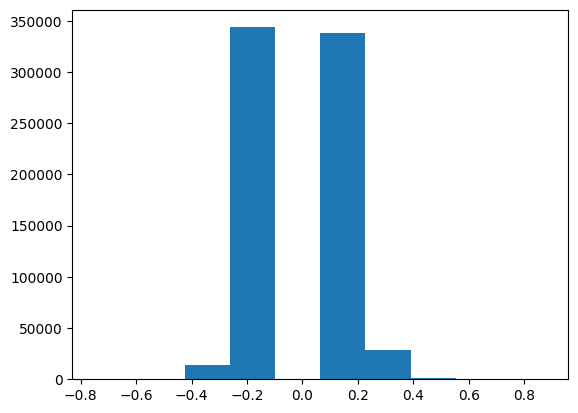

In [38]:
plt.hist(data.tbln_H3K27ac)

In [41]:
# scipy.stats.t.sf(data.ITC_NN_ATAC.values, df=2)

In [42]:
# scipy.stats.t.sf(data.ITC_NN_ATAC.values, df=3)

,chrom,pos,name,tbln_H3K27ac,diff,abs_diff,exp,zscore,p
0,10,84139514.0,rs932821133,0.105500,0.105500,0.105500,0.899874,0.658540,0.255096
1,10,84139543.0,rs1229596357,-0.183456,-0.183456,0.183456,1.201363,-1.181742,0.881346
2,10,84139573.0,rs1481839079,0.143182,0.143182,0.143182,0.866597,0.898519,0.184454
3,10,84140064.0,rs1452183496,0.136644,0.136644,0.136644,0.872280,0.856886,0.195754
4,10,84140294.0,rs1429667538,0.100358,0.100358,0.100358,0.904514,0.625787,0.265727
...,...,...,...,...,...,...,...,...,...
726226,3,194089744.0,rs1351149363,-0.218239,-0.218239,0.218239,1.243884,-1.403260,0.919730
726227,3,194089846.0,rs890061713,-0.116548,-0.116548,0.116548,1.123611,-0.755621,0.775062
726228,3,194089911.0,rs1246306491,-0.164336,-0.164336,0.164336,1.178611,-1.059971,0.855421
726229,3,194090129.0,rs1181593567,-0.111510,-0.111510,0.111510,1.117965,-0.723538,0.765325


In [51]:
data.chrom.unique()

array([10,  1, 16, 23, 15, 21,  2,  6,  7,  5, 12, 19,  8,  3,  9,  4, 11,
       24, 13, 14, 17, 22, 20, 18])

In [52]:
data.to_csv('data_with_pvalue.csv', index=False)

In [56]:
dash_bio.ManhattanPlot(dataframe=df, chrm='CHR', bp='BP', snp='SNP', p='P')

In [ ]:
file_lists = [files[:500], files[500:1000], files[1000:1500], files[1500:2000], files[2000:2500], files[2500:3000],
              files[3000:3500], files[3500:4000], files[4000:4500], files[4500:5000], files[5000:]]

In [55]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/dash-bio-docs-files/master/manhattan_data.csv')
df

,CHR,BP,P,SNP,ZSCORE,EFFECTSIZE,GENE,DISTANCE
0,1,937641,0.335344,rs9697358,0.9634,-0.0946,ISG15,1068
1,1,1136887,0.245857,rs34945898,1.1605,-0.0947,TNFRSF4,0
2,1,2116240,0.823286,rs12034613,0.2233,-0.0741,FP7162,0
3,1,2310562,0.493204,rs4648633,0.6852,0.0146,MORN1,0
4,1,2681715,0.605392,rs4430271,0.5167,0.1234,MMEL1,127427
...,...,...,...,...,...,...,...,...
14407,23,153207974,0.574920,rs766418,0.5608,-0.0190,NaN,-1
14408,23,153280339,0.978400,rs11593,0.0271,-0.1355,NaN,-1
14409,23,153546061,0.056012,rs5987005,1.9109,0.0026,NaN,-1
14410,23,153903746,0.132189,rs28370194,1.5055,-0.1425,NaN,-1


In [29]:
# dash_bio.ManhattanPlot(dataframe=data, chrm='CHR', bp='pos')

In [2]:
files = [i for i in range(5561)]
len(files)

5561

In [9]:
i = 0
step = 500
file_lists = []
while i+step <= len(files):
    print(i)
    flist = files[i:i+step]
    i+=step
    file_lists.append(flist)
    
flist = files[i:]
file_lists.append(flist)
print(len(file_lists))

0
500
1000
1500
2000
2500
3000
3500
4000
4500
5000
12


In [10]:
len(file_lists[-1])

61

## 